<a href="https://colab.research.google.com/github/dh565/Remote_Sensing_Course/blob/main/satpy_MSG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import satpy
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [ ]:
scn  = satpy.Scene(reader='seviri_l1b_nc', filenames=['W_XX-EUMETSAT-Darmstadt,VIS+IR+HRV+IMAGERY,MSG1+SEVIRI_C_EUMG_20060402120009.nc'])

In [ ]:
scn.attrs

{'sensor': {'seviri'},
 'start_time': datetime.datetime(2006, 4, 2, 12, 0, 9, 403000),
 'end_time': datetime.datetime(2006, 4, 2, 12, 15, 10, 246000)}

In [ ]:
scn.all_dataset_names()

['HRV',
 'IR_016',
 'IR_039',
 'IR_087',
 'IR_097',
 'IR_108',
 'IR_120',
 'IR_134',
 'VIS006',
 'VIS008',
 'WV_062',
 'WV_073']

In [ ]:
scn.load(["VIS006",'VIS008','IR_016','WV_073','WV_062',"VIS008","IR_097"]) 

In [ ]:
scn.keys()# the VIS006 and VIS008 have IR_016 are been calibration  to reflectance automatically satpy 


[DataID(name='IR_016', wavelength=WavelengthRange(min=1.5, central=1.64, max=1.78, unit='µm'), resolution=3000.403165817, calibration=<calibration.reflectance>, modifiers=()),
 DataID(name='IR_097', wavelength=WavelengthRange(min=9.38, central=9.66, max=9.94, unit='µm'), resolution=3000.403165817, calibration=<calibration.brightness_temperature>, modifiers=()),
 DataID(name='VIS006', wavelength=WavelengthRange(min=0.56, central=0.635, max=0.71, unit='µm'), resolution=3000.403165817, calibration=<calibration.reflectance>, modifiers=()),
 DataID(name='VIS008', wavelength=WavelengthRange(min=0.74, central=0.81, max=0.88, unit='µm'), resolution=3000.403165817, calibration=<calibration.reflectance>, modifiers=()),
 DataID(name='WV_062', wavelength=WavelengthRange(min=5.35, central=6.25, max=7.15, unit='µm'), resolution=3000.403165817, calibration=<calibration.brightness_temperature>, modifiers=()),
 DataID(name='WV_073', wavelength=WavelengthRange(min=6.85, central=7.35, max=7.85, unit='µm'

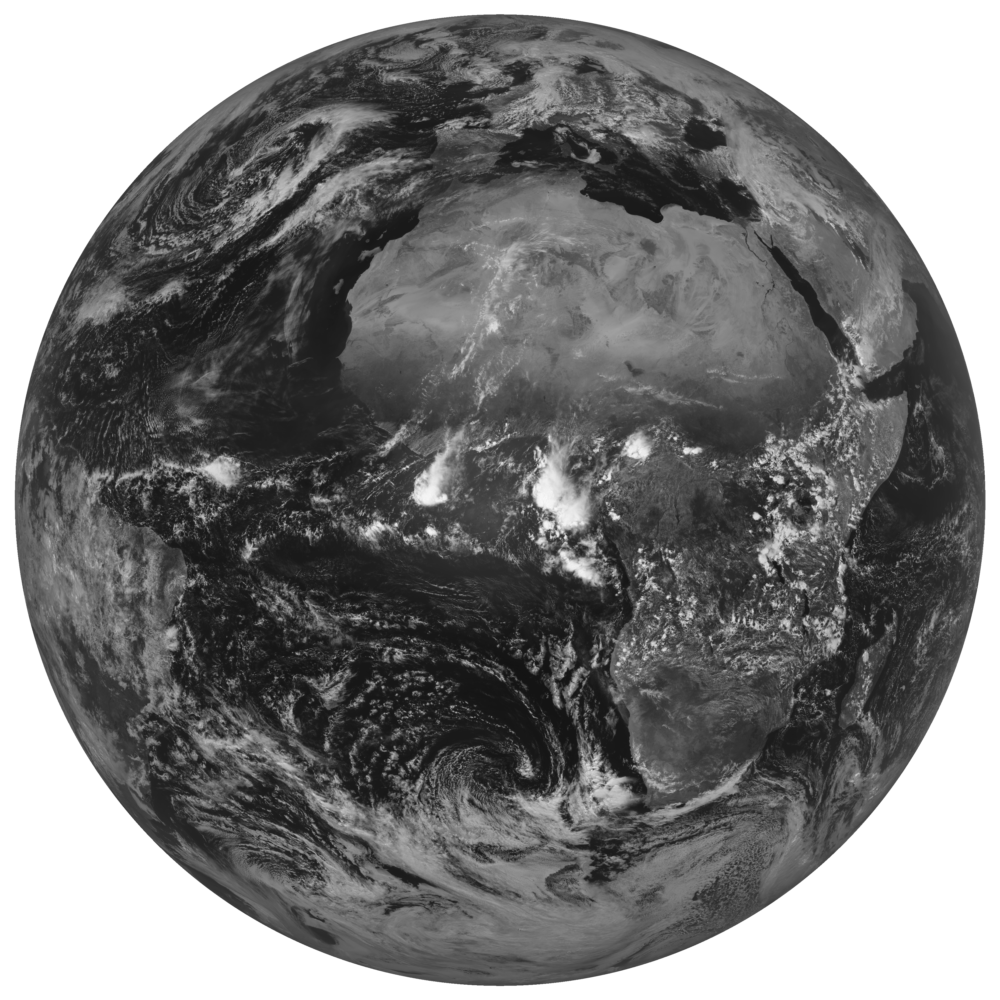

In [ ]:
scn.show("VIS006")

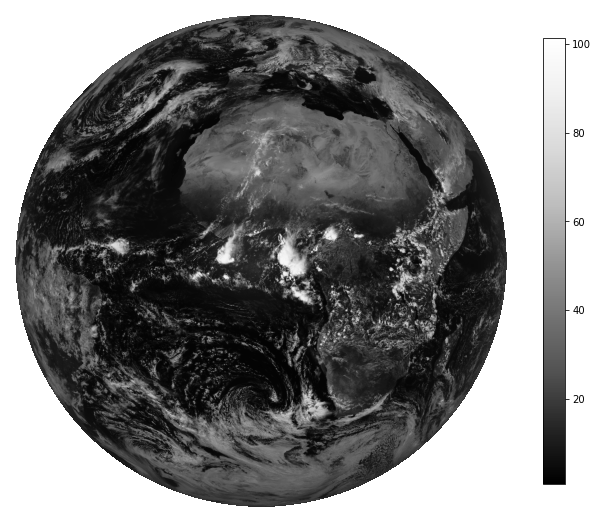

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
plt.imshow(scn["VIS006"].values, cmap="Greys_r")
ax.set_axis_off()
plt.colorbar(fraction=.04)
plt.show()


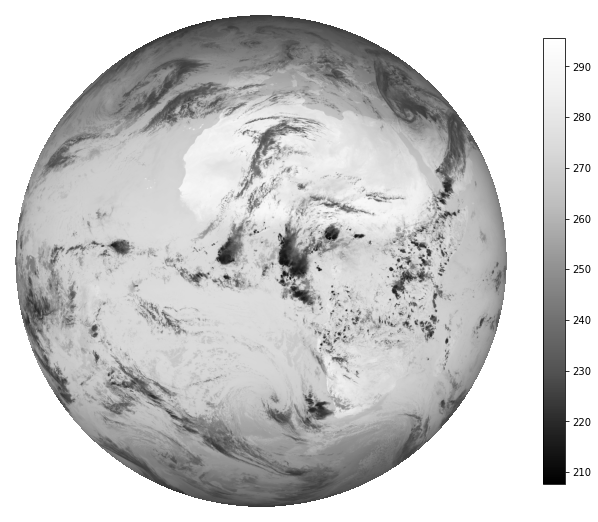

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
plt.imshow(scn["IR_097"].values, cmap="Greys_r")
ax.set_axis_off()
plt.colorbar(fraction=.04)
plt.show()


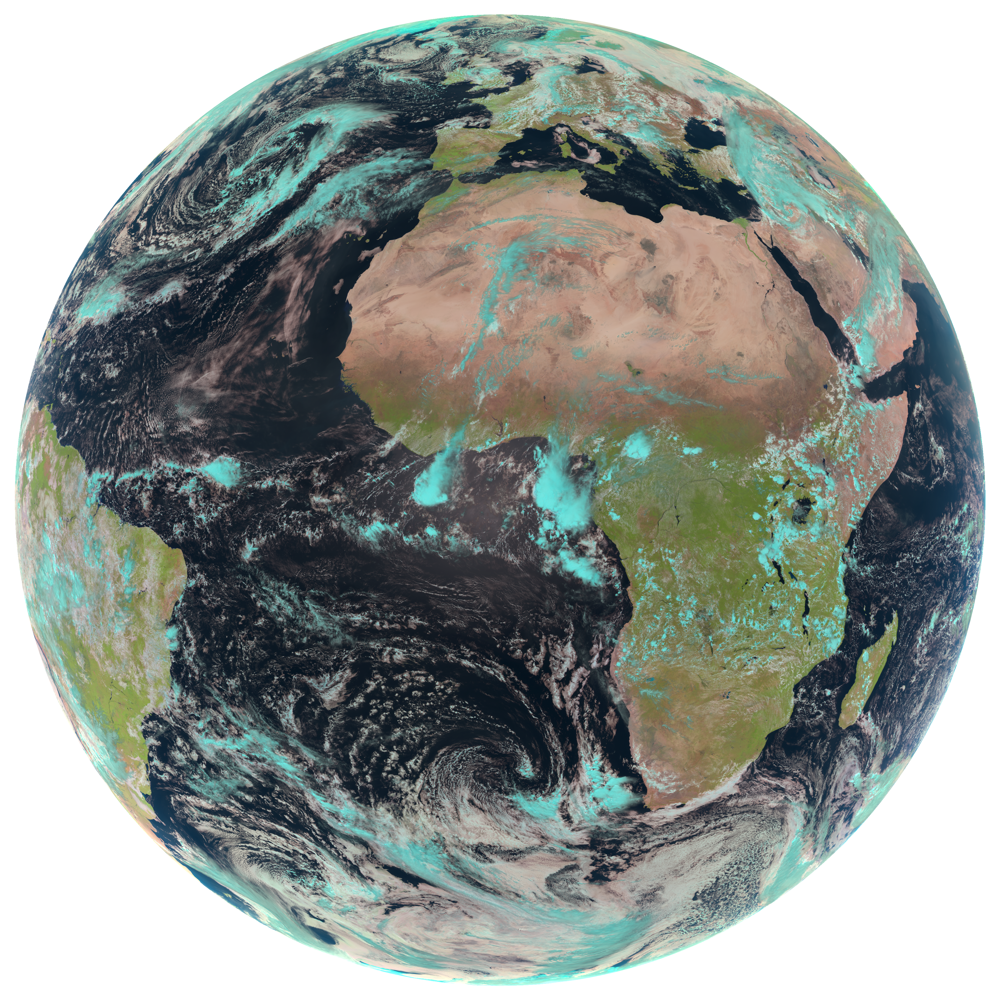

In [ ]:
scn.load(["natural_color"])
scn.show("natural_color")

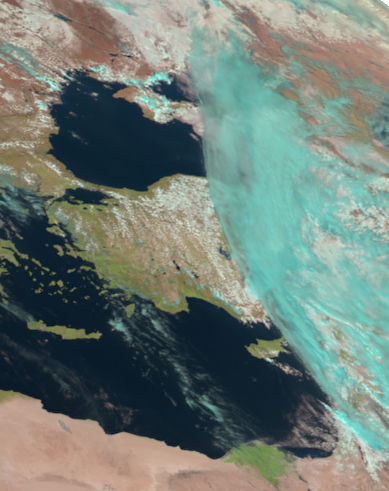

In [ ]:
# Crop to a region via lat/lon values (lon_min, lat_min, lon_max, lat_max)
scn_cropped = scn.crop(ll_bbox=(30, 30, 36, 50))
scn_cropped.show("natural_color")